## importing

In [1]:
import os
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [6]:
train=pd.read_csv('../input/global-wheat-detection/train.csv')
sample_output = pd.read_csv('../input/global-wheat-detection/sample_submission.csv')

In [7]:
train.tail()

,image_id,width,height,bbox,source
147788,5e0747034,1024,1024,"[64.0, 619.0, 84.0, 95.0]",arvalis_2
147789,5e0747034,1024,1024,"[292.0, 549.0, 107.0, 82.0]",arvalis_2
147790,5e0747034,1024,1024,"[134.0, 228.0, 141.0, 71.0]",arvalis_2
147791,5e0747034,1024,1024,"[430.0, 13.0, 184.0, 79.0]",arvalis_2
147792,5e0747034,1024,1024,"[875.0, 740.0, 94.0, 61.0]",arvalis_2


In [71]:
print(train['source'].unique())

['usask_1' 'arvalis_1' 'inrae_1' 'ethz_1' 'arvalis_3' 'rres_1' 'arvalis_2']


In [79]:
train.drop(['width','height'],axis=1, inplace= True)

In [80]:
sample_output.tail()

,image_id,PredictionString
5,348a992bb,1.0 0 0 50 50
6,cc3532ff6,1.0 0 0 50 50
7,2fd875eaa,1.0 0 0 50 50
8,cb8d261a3,1.0 0 0 50 50
9,53f253011,1.0 0 0 50 50


## number of (bbox)bounding-box one image can contain at max
* image id = 35b935b6c	contains 116 bounding box

In [82]:
train1=train
df = train1.drop_duplicates().groupby('image_id').count()
df.sort_values(by=['bbox'],ascending= False)

,bbox,source
image_id,,
35b935b6c,116,116
f1794c924,108,108
f79336a8e,104,104
134d4a01c,101,101
b70c20580,97,97
...,...,...
22f341965,1,1
86296fc32,1,1
ce4124be0,1,1


# some of the images are not annotated

In [171]:
path, dirs, files = next(os.walk("../input/global-wheat-detection/train"))
file_count = len(files)
print("Total No. of images in  train directory :", file_count)
print('Total number of annotated images in train data :',len(train['image_id'].unique()),'\n')
print('--- > 49 images are unlabelled ')

Total No. of images in  train directory : 3422
Total number of annotated images in train data : 3373 

--- > 49 images are unlabelled 


## Finding,plotting and Removing unlabelled Garbage images

In [191]:
# train directory images name
sep = '.'
images_dir=[]
for image in files:
    rest = image.split(sep, 1)[0]
    images_dir.append(rest)
    
# train data labelled images name
image_labelled =[]
for i in train['image_id']:
    image_labelled.append(i)

# extracting unlabelled images by comparing train dir. images and train.csv dataset      
unlabelled_images= [x for x in images_dir if x not in image_labelled]

print(len(unlabelled_images),'images are :')
unlabelled=[]
for h in unlabelled_images:
    unlabelled.append(h+'.jpg')
unlabelled

49 images are :


['e4ec17f9b.jpg',
 'dec23c826.jpg',
 '45fddc611.jpg',
 '155c440e8.jpg',
 '00b5c6764.jpg',
 'ccb3892c1.jpg',
 '5901a73fe.jpg',
 'ab20ec355.jpg',
 'e01ad95cf.jpg',
 'f9cafa47f.jpg',
 'cfc9040ca.jpg',
 'dd5d2fa9e.jpg',
 '5cbd092f9.jpg',
 '952e7d15c.jpg',
 'b45c5294d.jpg',
 'f530a5d4b.jpg',
 'd83808467.jpg',
 '2e6c333a7.jpg',
 '9e21e7969.jpg',
 '8a5cb62db.jpg',
 'd771bb084.jpg',
 '8425a537b.jpg',
 'de2a3cf37.jpg',
 'c18c32da0.jpg',
 'ec196d18a.jpg',
 '8de789df8.jpg',
 '3116768f0.jpg',
 'ffbb9c623.jpg',
 'f2a6804d2.jpg',
 '0cf7ef43d.jpg',
 '7e1caf1f7.jpg',
 '2d80f9c49.jpg',
 '83a94fc79.jpg',
 '1a9792bfc.jpg',
 'd7e657453.jpg',
 'ed00a614d.jpg',
 '6584c18c0.jpg',
 'cf1d2f504.jpg',
 '65d0b13aa.jpg',
 '69352f3fa.jpg',
 '581eaf87b.jpg',
 '0e7832f0b.jpg',
 'c74ca81bd.jpg',
 '49e40c7a4.jpg',
 '91d4e3750.jpg',
 '526d737d1.jpg',
 '46c6a747a.jpg',
 'a3ce975cd.jpg',
 '39a0e5556.jpg']

## let's see are the images can be used

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


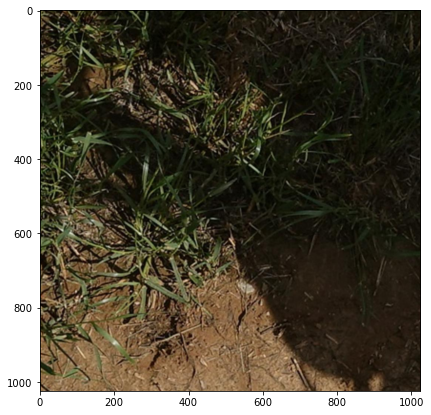

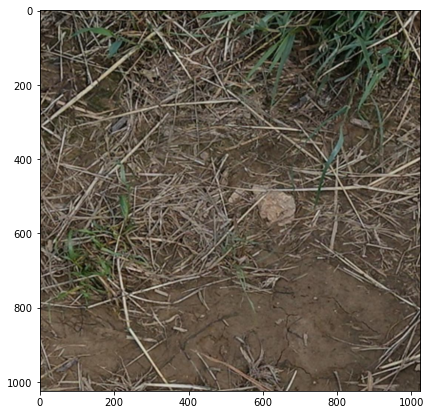

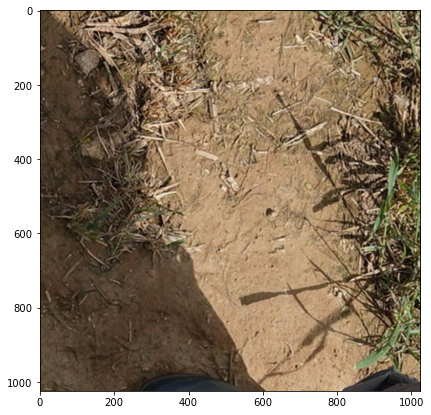

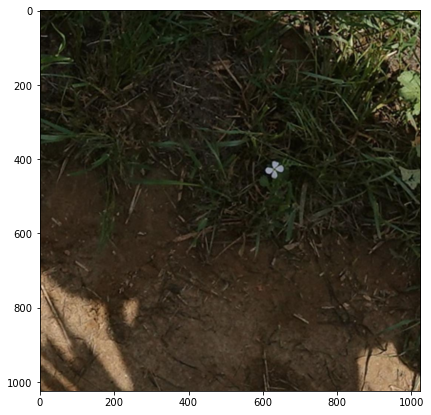

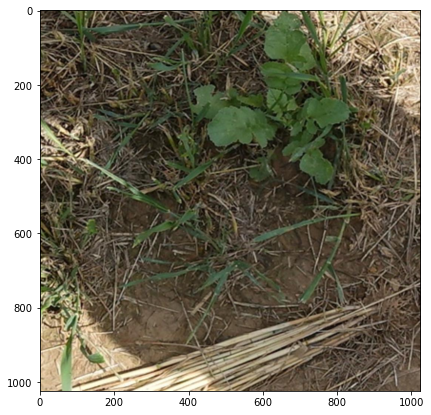

...

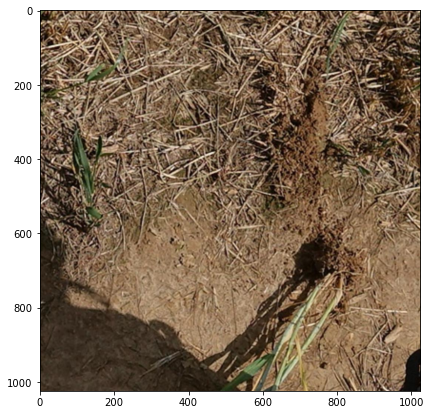

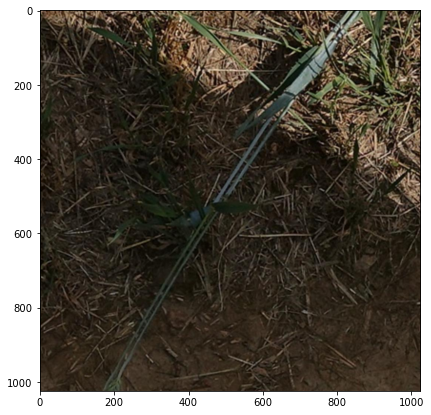

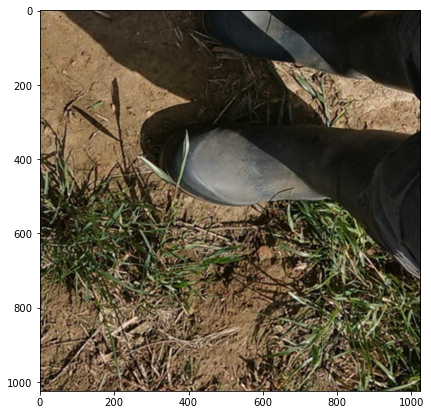

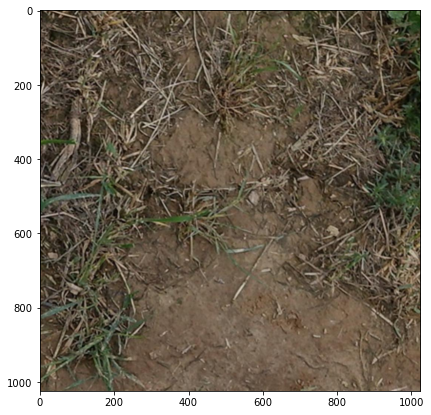

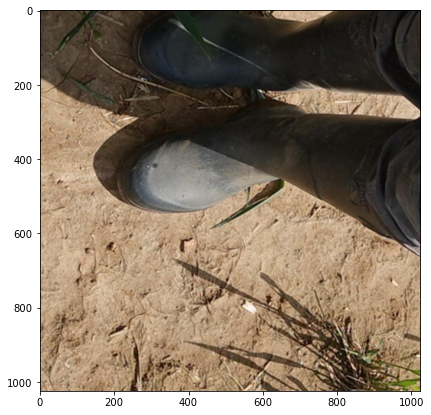

In [190]:
for i in unlabelled:
    img = cv2.imread('../input/global-wheat-detection/train/'+i)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(15, 15))
    plt.subplot(1, 2, 1)
    plt.imshow(img)

## plotting how the train images are annotated

In [187]:
def plot():
    color = (0,0,255) 
    thickness = 2
    xmax =xmin+width
    ymax =ymin+height
    
    img = cv2.imread('../input/global-wheat-detection/train/'+image_id+'.jpg')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img= cv2.rectangle(img,(xmin,ymin), (xmax,ymax),color,thickness)

    plt.figure(figsize=(20, 20))
    plt.subplot(1, 2, 1)
    plt.imshow(img)

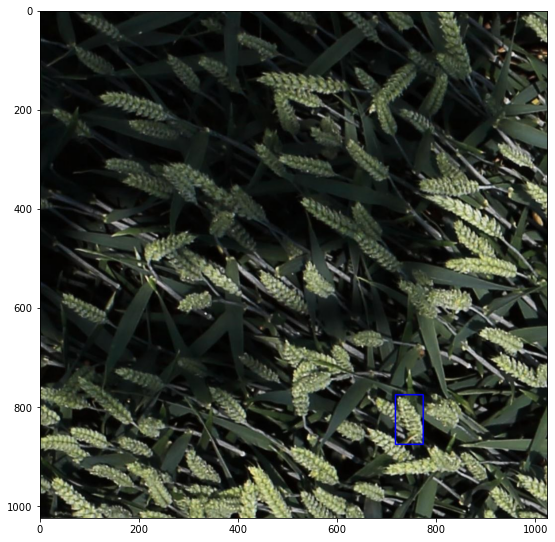

In [188]:
image_id = '35b935b6c'
xmin,ymin,width,height = 716, 775, 56, 100
plot()

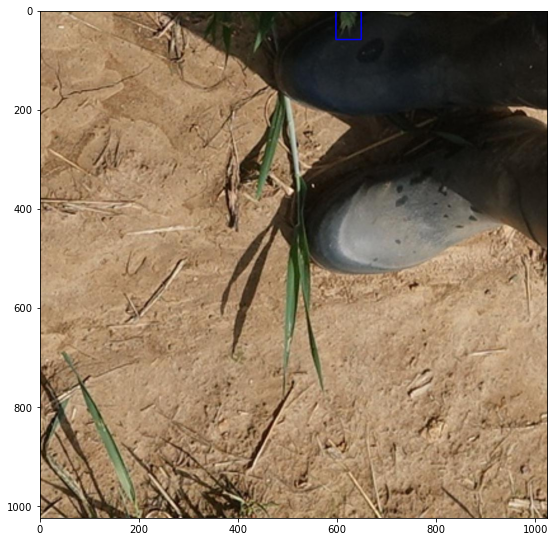

In [95]:
image_id= '76595919e'
xmin,ymin,width,height= 596, 1, 51, 58
plot()